# Assignment 1

## Q1

### 1a

In [2]:
%matplotlib inline
import matplotlib.pyplot as pp
import numpy as np
import scipy.signal as ss
import librosa
import librosa.display
from IPython import display
import scipy.io.wavfile as wf

In [2]:
### Reference: This code is from lecture note ###
# A simple wrapper class for (1-channel) audio data
# data is a 1-D NumPy array containing the data
# rate is a number expressing the samples per second
class Audio:
    def __init__(self, data, rate):
        self.data = data
        self.rate = rate
    def play(self):
        return display.Audio(self.data, rate=self.rate)
    def plot_wave(self):
        librosa.display.waveplot(self.data, sr=self.rate)
    def plot_spectrum(self):
        n_fft = int(self.rate / 20)
        D = librosa.amplitude_to_db(np.abs(librosa.stft(self.data, n_fft)), ref=np.max)
        librosa.display.specshow(D, y_axis='linear', sr=self.rate, hop_length=n_fft/4)
    @classmethod
    def fromfile(cls, fn):
        return cls(*librosa.load(fn, sr=None))

In [3]:
# Load a linear frequency sweep from 0-4000Hz
# generated using Adobe Audition
q1 = Audio.fromfile("q1.wav")

In [4]:
# Sample rate we use is 48000Hz
q1.rate

48000

In [5]:
q1.play()

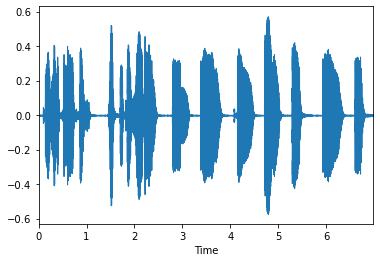

In [6]:
q1.plot_wave()

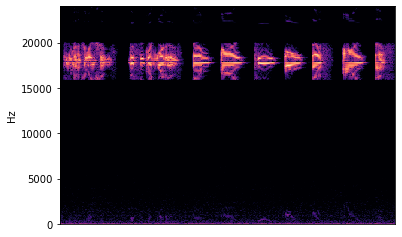

In [7]:
q1.plot_spectrum()

(15000.0, 21000.0)

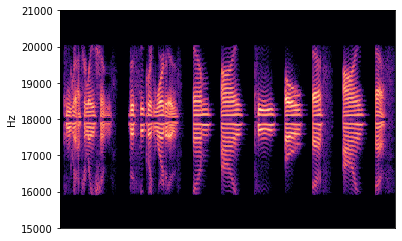

In [8]:
q1.plot_spectrum()
pp.ylim(15000,21000)

Text(0, 0.5, 'Energy')

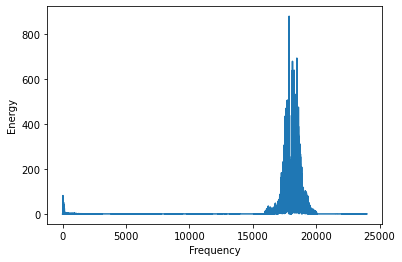

In [9]:
# taking FFT to determine exact frequence
q1_fft = np.fft.rfft(q1.data)
q1_freq = np.fft.rfftfreq(len(q1.data), 1/q1.rate)
pp.plot(q1_freq, np.abs(q1_fft))
pp.xlabel("Frequency")
pp.ylabel("Energy")

In [10]:
q1_eng = np.abs(q1_fft)
ultra_freq = q1_freq[q1_eng.argmax()]
print("The ultrasound frequency is ", ultra_freq)

The ultrasound frequency is  17868.184759626998


The ultrasound frequency is 17868 Hz (around 18000 Hz) based on the RFFT graph.

### 1b

In [11]:
# Downsample by a factor of 2, to get a sample rate of 48000/2 = 24000Hz
# This makes the maximum representable frequency 12000Hz, below the ultrasound frequency
# which may achieve the goal to recover the original audio
q1_rcv1 = Audio(q1.data[::2], q1.rate//2)

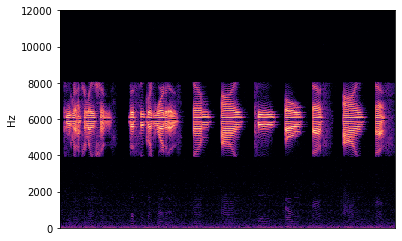

In [12]:
q1_rcv1.plot_spectrum()

In [13]:
q1_rcv1.play()

In [14]:
# The sound above is very nois and could not hear clearly
# Need to downsample more
# Downsample by a factor of 4, to get a sample rate of 48000/4 = 12000Hz
q1_rcv2 = Audio(q1.data[::4], q1.rate//4)

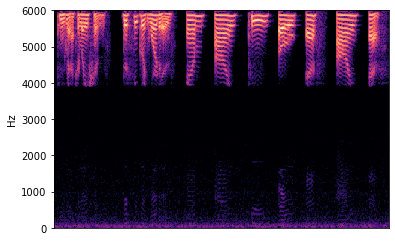

In [15]:
q1_rcv2.plot_spectrum()

In [16]:
q1_rcv2.play()

In [17]:
# Downsample by a factor of 8, to get a sample rate of 48000/8 = 6000Hz

In [18]:
q1_rcv3 = Audio(q1.data[::8], q1.rate//8)

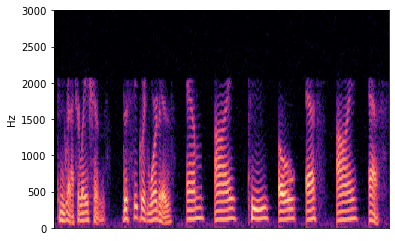

In [19]:
q1_rcv3.plot_spectrum()

In [20]:
# Final result
q1_rcv3.play()

Secret word: **mitosis**

## Q2

In [21]:
# read audio file
q2 = Audio.fromfile("q2.wav")
q2.play()

In [22]:
print("sample rate: ", q2.rate)
print("signal size: ", len(q2.data))

sample rate:  48000
signal size:  3513600


In [23]:
# total number of bits transmitted
bits = len(q2.data) / q2.rate * 20 
bits

1464.0

In [24]:
# the smaple size corresponding to 1 bit
num_data = len(q2.data)/bits
num_data

2400.0

In [25]:
# extract binary code in the audio file by slicing the audio file into 1464 chunks, i.e. 1464 bits
# each bit need to collect 2400 data to analyze
# and do rfft to each chunk and compare the maximum enrgery of frequency 
# is equal to 5000Hz or not
Q2 = ''
for i in np.arange(0, len(q2.data), 2400):
    q2_fft = np.fft.rfft(q2.data[i:i+2400])
    q2_freq = np.fft.rfftfreq(2400, 1/q2.rate)
    arg_freq = q2_freq[np.abs(q2_fft).argmax()]
    if arg_freq == 5000:
        Q2 += '1'
    else:
        Q2 += '0'

In [26]:
# binary numbers to acsii text
text = ''
for q in range(0,len(Q2),8):
    int_q = int(Q2[q:q+8],2)
    chr_q2 = chr(int_q)
    text += chr_q2

print(text)

     "Oh, the rare old Whale, mid storm and gale
     In his ocean home will be
     A giant in might, where might is right,
     And King of the boundless sea."
      -- Whale Song.



## Q3

In [27]:
q3 = Audio.fromfile("q3.wav")
q3.play()

In [28]:
print("sample rate: ", q3.rate)
print("signal size: ", len(q3.data))

sample rate:  48000
signal size:  5207214


In [29]:
# 4 notes per second, 1 second collects 48000 data 
# --> 1 note contains 48000 / 4 = 12000 data

Q3 = []
for i in np.arange(0, len(q3.data), 12000):
    q3_fft = np.fft.rfft(q3.data[i:i+12000])
    q3_freq = np.fft.rfftfreq(12000, 1/q3.rate)
    q3_arg_freq = q3_freq[np.abs(q3_fft).argmax()]
    Q3.append(q3_arg_freq)

In [30]:
# ignore the first 120 (30 seconds) the last 20 notes (5 seconds)
Q3[120:-20]

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 656.0,
 876.0,
 832.0,
 876.0,
 1044.0,
 876.0,
 656.0,
 436.0,
 656.0,
 876.0,
 832.0,
 876.0,
 1044.0,
 876.0,
 656.0,
 436.0,
 1568.0,
 656.0,
 696.0,
 832.0,
 696.0,
 656.0,
 588.0,
 1568.0,
 656.0,
 832.0,
 876.0,
 328.0,
 588.0,
 1568.0,
 1480.0,
 436.0,
 1568.0,
 656.0,
 696.0,
 832.0,
 696.0,
 656.0,
 588.0,
 1568.0,
 656.0,
 832.0,
 876.0,
 328.0,
 588.0,
 1568.0,
 1480.0,
 436.0,
 1568.0,
 832.0,
 436.0,
 696.0,
 588.0,
 832.0,
 436.0,
 328.0,
 1568.0,
 832.0,
 436.0,
 292.0,
 1568.0,
 1480.0,
 436.0,
 832.0,
 328.0,
 832.0,
 1480.0,
 656.0,
 832.0,
 988.0,
 1168.0,
 1392.0,
 1168.0,
 988.0,
 832.0,
 656.0,
 588.0,
 1568.0,
 1480.0,
 1568.0,
 436.0,
 1568.0,
 656.0,
 876.0,
 1044.0,
 1312.0,
 696.0,
 784.0,
 928.0,
 784.0,
 656.0,
 1568.0,
 464.0,
 436.0,
 784.0,
 436.0,
 696.0,
 436.0,
 1568.0,
 588.0,
 696.0,
 876.0,
 1568.0,
 1480.0,
 784.0,
 1480.0,
 588.0,
 656.0,
 784.0,
 988.0,
 588.0,
 1568.0,
 436.0,
 1568.0,
 65

In [31]:
# the first 9 notes are 0, so discard them and make a new note list
Q3_new = Q3[129:-20]
Q3_new

[656.0,
 876.0,
 832.0,
 876.0,
 1044.0,
 876.0,
 656.0,
 436.0,
 656.0,
 876.0,
 832.0,
 876.0,
 1044.0,
 876.0,
 656.0,
 436.0,
 1568.0,
 656.0,
 696.0,
 832.0,
 696.0,
 656.0,
 588.0,
 1568.0,
 656.0,
 832.0,
 876.0,
 328.0,
 588.0,
 1568.0,
 1480.0,
 436.0,
 1568.0,
 656.0,
 696.0,
 832.0,
 696.0,
 656.0,
 588.0,
 1568.0,
 656.0,
 832.0,
 876.0,
 328.0,
 588.0,
 1568.0,
 1480.0,
 436.0,
 1568.0,
 832.0,
 436.0,
 696.0,
 588.0,
 832.0,
 436.0,
 328.0,
 1568.0,
 832.0,
 436.0,
 292.0,
 1568.0,
 1480.0,
 436.0,
 832.0,
 328.0,
 832.0,
 1480.0,
 656.0,
 832.0,
 988.0,
 1168.0,
 1392.0,
 1168.0,
 988.0,
 832.0,
 656.0,
 588.0,
 1568.0,
 1480.0,
 1568.0,
 436.0,
 1568.0,
 656.0,
 876.0,
 1044.0,
 1312.0,
 696.0,
 784.0,
 928.0,
 784.0,
 656.0,
 1568.0,
 464.0,
 436.0,
 784.0,
 436.0,
 696.0,
 436.0,
 1568.0,
 588.0,
 696.0,
 876.0,
 1568.0,
 1480.0,
 784.0,
 1480.0,
 588.0,
 656.0,
 784.0,
 988.0,
 588.0,
 1568.0,
 436.0,
 1568.0,
 656.0,
 696.0,
 876.0,
 1044.0,
 656.0,
 588.0,
 1480.0,

In [32]:
q3_keys = ["C4", "C#4", "D4", "D#4", "E4", "F4", "F#4", "G4", "G#4", "A4", "A#4", "B4",
       "C5", "C#5", "D5", "D#5", "E5", "F5", "F#5", "G5", "G#5", "A5", "A#5", "B5",
       "C6", "C#6", "D6", "D#6", "E6", "F6", "F#6", "G6", "G#6", "A6", "A#6", "B6"]

# C4 note frequency: 261.63
q3_values = []
for i in range(36):
    note_freq = 261.63 * 2 ** ((1/12)*i)
    q3_values.append(note_freq)

# dictionary each note and its frequency
q3_notes = dict(zip(q3_keys, q3_values))
q3_notes

{'C4': 261.63,
 'C#4': 277.18732937722245,
 'D4': 293.66974569918125,
 'D#4': 311.1322574981619,
 'E4': 329.63314428399565,
 'F4': 349.2341510465061,
 'F#4': 370.00069432367286,
 'G4': 392.0020805232462,
 'G#4': 415.31173722644,
 'A4': 440.00745824565865,
 'A#4': 466.1716632541139,
 'B4': 493.8916728538229,
 'C5': 523.26,
 'C#5': 554.3746587544449,
 'D5': 587.3394913983624,
 'D#5': 622.2645149963238,
 'E5': 659.2662885679913,
 'F5': 698.4683020930121,
 'F#5': 740.0013886473457,
 'G5': 784.0041610464924,
 'G#5': 830.62347445288,
 'A5': 880.0149164913173,
 'A#5': 932.3433265082278,
 'B5': 987.7833457076458,
 'C6': 1046.52,
 'C#6': 1108.7493175088896,
 'D6': 1174.6789827967248,
 'D#6': 1244.5290299926476,
 'E6': 1318.5325771359824,
 'F6': 1396.9366041860242,
 'F#6': 1480.0027772946914,
 'G6': 1568.0083220929844,
 'G#6': 1661.24694890576,
 'A6': 1760.0298329826346,
 'A#6': 1864.6866530164555,
 'B6': 1975.5666914152916}

In [33]:
trans = ''
for q in Q3_new:
    idx = (np.abs((q3_values) - q)).argmin()
    tr = q3_keys[idx]
    trans = trans + tr + str(", ")
print(trans)

E5, A5, G#5, A5, C6, A5, E5, A4, E5, A5, G#5, A5, C6, A5, E5, A4, G6, E5, F5, G#5, F5, E5, D5, G6, E5, G#5, A5, E4, D5, G6, F#6, A4, G6, E5, F5, G#5, F5, E5, D5, G6, E5, G#5, A5, E4, D5, G6, F#6, A4, G6, G#5, A4, F5, D5, G#5, A4, E4, G6, G#5, A4, D4, G6, F#6, A4, G#5, E4, G#5, F#6, E5, G#5, B5, D6, F6, D6, B5, G#5, E5, D5, G6, F#6, G6, A4, G6, E5, A5, C6, E6, F5, G5, A#5, G5, E5, G6, A#4, A4, G5, A4, F5, A4, G6, D5, F5, A5, G6, F#6, G5, F#6, D5, E5, G5, B5, D5, G6, A4, G6, E5, F5, A5, C6, E5, D5, F#6, D5, F#5, G5, B5, D6, F5, E5, G5, C6, B5, C6, E6, C6, G5, G6, G5, C6, B5, C6, E6, C6, G5, G6, G5, A#5, A5, A#5, E6, A#5, G5, G6, G5, A#5, A5, A#5, E6, A#5, G5, C#5, G5, A#5, A5, A#5, E6, A#5, G5, C#5, G5, E5, C#5, A4, G5, F5, E4, D4, G5, F5, E5, F5, A5, F5, F5, F#6, G#5, F#6, D5, E5, D5, G6, F#6, G6, E5, A5, G#5, A5, C6, A5, F#5, D#5, F#6, D#5, F#5, B5, A5, G5, F#5, G5, F#5, E5, G5, A4, E5, G5, C6, F#5, E5, D5, F#5, G5, D5, F#5, B5, E5, D5, G6, E5, F#5, E5, F#5, A5, D#5, F#6, G6, A4, D#4, 

## Q4

In [100]:
from PIL import Image

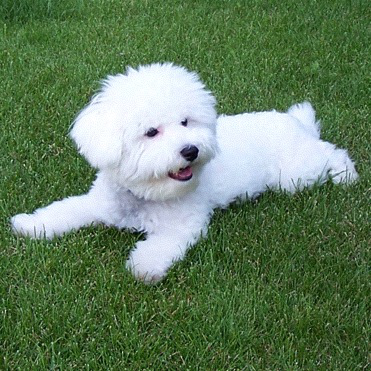

In [101]:
img = Image.open('./q4.png','r')
img

In [102]:
# convert image into numpy array
array = np.array(img.getdata())
array

array([[47, 87, 39],
       [33, 71, 25],
       [45, 85, 41],
       ...,
       [57, 85, 43],
       [67, 93, 53],
       [43, 69, 31]])

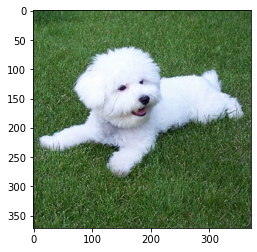

In [145]:
Array = array.reshape((371,371,3))

img_A = Image.fromarray((Array).astype(np.uint8))
pp.imshow(img_A)

In [109]:
array.shape # array size

(137641, 3)

In [38]:
img.mode # RGB image

'RGB'

In [39]:
img.size

(371, 371)

In [40]:
# calculate total pixels
pixel_tot = array.size//3
pixel_tot

137641

In [ ]:
# extract LSB from top left of the image
hidden_bits = ""

for i in range(pixel_tot):
    for j in range(0,3):
        hidden_bits += (bin(array[i][j])[-1])
hidden_bits

In [42]:
# after analyzing hidden_bits, it's made up of many 1
# seems like it's can be converted to a greyscale image corresponding to each pixel
# group bits to three per group
group = [hidden_bits[i:i+3] for i in range(0,len(hidden_bits),3)]
group

['111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',
 '111',


In [43]:
# convert binary to decimal
A = []
for i in range(0,len(group)):
    a = int(group[i],2)
    A.append(np.array(a))
A = np.array(A)
A.resize((371,371))
A

array([[7, 7, 7, ..., 7, 7, 7],
       [7, 7, 7, ..., 7, 7, 7],
       [7, 7, 7, ..., 7, 7, 7],
       ...,
       [7, 7, 7, ..., 7, 7, 7],
       [7, 7, 7, ..., 7, 7, 7],
       [7, 7, 7, ..., 7, 7, 7]])

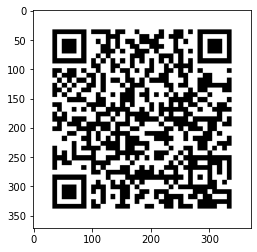

In [44]:
# convert the array to greyscale graph
img_1 = Image.fromarray((A / 7 * 255))
pp.imshow(img_1)

After decoding the image, it produced a QR code. And scanning this code, we could get the secret message as following:\
**"This is a secret message. Do not let this fall into enemy hands. Prepare to attack at dawn."**

In [73]:
"1"*300

'111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'

In [83]:
a = int("1"*10000,2)

In [114]:
MM = [1,2,3,6,0,1,3,7,2,5,5,4]
# MM = [0,0,0,0,0,1,3,0,2,0,5,0]
MM = np.array(MM)
MM

array([1, 2, 3, 6, 0, 1, 3, 7, 2, 5, 5, 4])

In [115]:
M = MM/7*255
M,M.shape

(array([ 36.42857143,  72.85714286, 109.28571429, 218.57142857,
          0.        ,  36.42857143, 109.28571429, 255.        ,
         72.85714286, 182.14285714, 182.14285714, 145.71428571]),
 (12,))

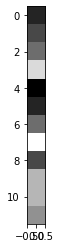

In [176]:
img_2 = Image.fromarray((M))
pp.imshow(img_2)

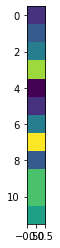

In [178]:
img_22 = Image.fromarray((M).astype(np.uint8))
pp.imshow(img_22)

In [117]:
int("110010",2)

50

In [118]:
int("110",2), int("010",2)

(6, 2)

In [119]:
int("110010110101010001",2)

208209

In [120]:
int("110010110",2), int("101010001",2)

(406, 337)

In [127]:
M1 = M*2
M2 = M+169
M3 = M**2

In [128]:
M12 = np.vstack((M1,M2)).T
M12, M12.shape

(array([[ 72.85714286, 205.42857143],
        [145.71428571, 241.85714286],
        [218.57142857, 278.28571429],
        [437.14285714, 387.57142857],
        [  0.        , 169.        ],
        [ 72.85714286, 205.42857143],
        [218.57142857, 278.28571429],
        [510.        , 424.        ],
        [145.71428571, 241.85714286],
        [364.28571429, 351.14285714],
        [364.28571429, 351.14285714],
        [291.42857143, 314.71428571]]),
 (12, 2))

In [129]:
M12.max()
MM12 = M12/M12.max()*255
MM12

array([[ 36.42857143, 102.71428571],
       [ 72.85714286, 120.92857143],
       [109.28571429, 139.14285714],
       [218.57142857, 193.78571429],
       [  0.        ,  84.5       ],
       [ 36.42857143, 102.71428571],
       [109.28571429, 139.14285714],
       [255.        , 212.        ],
       [ 72.85714286, 120.92857143],
       [182.14285714, 175.57142857],
       [182.14285714, 175.57142857],
       [145.71428571, 157.35714286]])

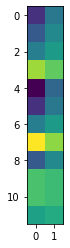

In [142]:
img_3 = Image.fromarray((MM12).astype(np.uint8))
pp.imshow(img_3)

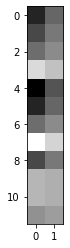

In [153]:
img_33 = Image.fromarray((MM12))
pp.imshow(img_33)

In [131]:
M123 = np.vstack((M1,M2,M3)).T
M123, M123.shape

(array([[   72.85714286,   205.42857143,  1327.04081633],
        [  145.71428571,   241.85714286,  5308.16326531],
        [  218.57142857,   278.28571429, 11943.36734694],
        [  437.14285714,   387.57142857, 47773.46938776],
        [    0.        ,   169.        ,     0.        ],
        [   72.85714286,   205.42857143,  1327.04081633],
        [  218.57142857,   278.28571429, 11943.36734694],
        [  510.        ,   424.        , 65025.        ],
        [  145.71428571,   241.85714286,  5308.16326531],
        [  364.28571429,   351.14285714, 33176.02040816],
        [  364.28571429,   351.14285714, 33176.02040816],
        [  291.42857143,   314.71428571, 21232.65306122]]),
 (12, 3))

In [135]:
M123.max()
MM123 = M123/M123.max()*255
MM123

array([[  0.28571429,   0.80560224,   5.20408163],
       [  0.57142857,   0.94845938,  20.81632653],
       [  0.85714286,   1.09131653,  46.83673469],
       [  1.71428571,   1.51988796, 187.34693878],
       [  0.        ,   0.6627451 ,   0.        ],
       [  0.28571429,   0.80560224,   5.20408163],
       [  0.85714286,   1.09131653,  46.83673469],
       [  2.        ,   1.6627451 , 255.        ],
       [  0.57142857,   0.94845938,  20.81632653],
       [  1.42857143,   1.37703081, 130.10204082],
       [  1.42857143,   1.37703081, 130.10204082],
       [  1.14285714,   1.23417367,  83.26530612]])

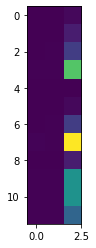

In [171]:
img_4 = Image.fromarray((MM123).astype(np.uint8))
pp.imshow(img_4)

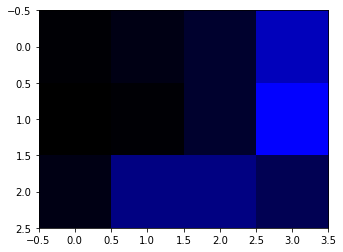

In [172]:
MM123_re = MM123.reshape(3,4,3)
img_44 = Image.fromarray((MM123_re).astype(np.uint8))
pp.imshow(img_44)

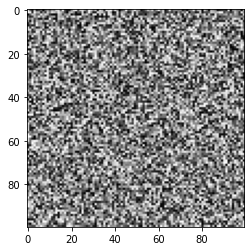

In [167]:
import numpy as np
from PIL import Image

# Creates a random image 100*100 pixels
mat = np.random.random((100,100))*255

# Creates PIL image
img_t = Image.fromarray((mat))
pp.imshow(img_t)

In [19]:
Matr = [[1,2,3], [4,5,6]]
type(Matr)


list

In [20]:
import numpy as np
Matr_a = np.array(Matr)
Matr_a

array([[1, 2, 3],
       [4, 5, 6]])

In [23]:
Matr_a.shape

(2, 3)

In [29]:
int("1111111111111111111111111111111111111111111111111111111111111111",2)

36893488147419103231

In [ ]:
1111111111111111